In [0]:
%pip install databricks-feature-store

Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.
Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.


In [0]:
dbutils.library.restartPython()

In [0]:
from databricks.feature_store import feature_table, FeatureStoreClient
import pyspark.pandas as ps
ps.set_option('compute.ops_on_diff_frames', True)
from pyspark.ml.feature import MinMaxScaler
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [0]:
# replace with your schema if you complete data engineering Silver Table Tasks
nba_df = spark.table("hackathon.team_4.play_by_play_silver")
display(nba_df)

game_id,game_date,event_num,event_type,event_action_type,period,minute_game,wc_time_string,time_quarter,minute_remaining_quarter,seconds_remaining_quarter,neutral_description,person1type,player1_id,person2type,player2_id,person3type,player3_id,video_available_flag,player1_name,player1_team_id,player1_team_city,player1_team_nickname,player1_team_abbreviation,player2_name,player2_team_id,player2_team_city,player2_team_nickname,player2_team_abbreviation,player3_name,player3_team_id,player3_team_city,player3_team_nickname,player3_team_abbreviation,score,away_score,home_score,score_margin,team_leading,season,event_column,home_team,away_team,play_description,score_margin_complete,score_complete,away_score_complete,home_score_complete,team_leading_complete
0011300036,10/11/2013 00:00:00,0,12,0,1,0.0,8:42 PM,12:00,12,0,Start of 1st Period (8:42 PM EST),0,0,0,0,0,0,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2013-14,0,MiamiHeat,CharlotteBobcats,null,0,0 - 0,0,0,Home
0011300036,10/11/2013 00:00:00,1,10,0,1,0.0,8:42 PM,12:00,12,0,null,4,2547,5,203469,4,2544,0,Chris Bosh,1610612748,Miami,Heat,MIA,Cody Zeller,1610612766,Charlotte,Bobcats,CHA,LeBron James,1610612748,Miami,Heat,MIA,null,null,null,null,null,2013-14,1,MiamiHeat,CharlotteBobcats,null,0,0 - 0,0,0,Home
0011300036,10/11/2013 00:00:00,2,2,1,1,0.25,8:43 PM,11:45,11,45,null,4,2592,0,0,0,0,0,James Jones,1610612748,Miami,Heat,MIA,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2013-14,2,MiamiHeat,CharlotteBobcats,null,0,0 - 0,0,0,Home
0011300036,10/11/2013 00:00:00,3,4,0,1,0.27,8:43 PM,11:44,11,44,null,5,203469,0,0,0,0,0,Cody Zeller,1610612766,Charlotte,Bobcats,CHA,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2013-14,3,MiamiHeat,CharlotteBobcats,null,0,0 - 0,0,0,Home
0011300036,10/11/2013 00:00:00,4,1,49,1,0.57,8:43 PM,11:26,11,26,null,5,2744,5,203469,0,0,0,Al Jefferson,1610612766,Charlotte,Bobcats,CHA,Cody Zeller,1610612766,Charlotte,Bobcats,CHA,null,null,null,null,null,2 - 0,2,0,-2,Away,2013-14,4,MiamiHeat,CharlotteBobcats,null,-2,2 - 0,2,0,Away
0011300036,10/11/2013 00:00:00,5,5,2,1,0.93,8:43 PM,11:04,11,4,null,4,2547,5,202689,0,0,0,Chris Bosh,1610612748,Miami,Heat,MIA,Kemba Walker,1610612766,Charlotte,Bobcats,CHA,null,null,null,null,null,2 - 0,2,0,-2,Away,2013-14,5,MiamiHeat,CharlotteBobcats,Bosh Lost Ball Turnover (P1.T1)Walker STEAL (1 STL),-2,2 - 0,2,0,Away
0011300036,10/11/2013 00:00:00,6,2,1,1,1.12,8:43 PM,10:53,10,53,null,5,201945,0,0,0,0,0,Gerald Henderson,1610612766,Charlotte,Bobcats,CHA,null,null,null,null,null,null,null,null,null,null,2 - 0,2,0,-2,Away,2013-14,6,MiamiHeat,CharlotteBobcats,null,-2,2 - 0,2,0,Away
0011300036,10/11/2013 00:00:00,7,4,0,1,1.13,8:43 PM,10:52,10,52,null,4,2617,0,0,0,0,0,Udonis Haslem,1610612748,Miami,Heat,MIA,null,null,null,null,null,null,null,null,null,null,2 - 0,2,0,-2,Away,2013-14,7,MiamiHeat,CharlotteBobcats,null,-2,2 - 0,2,0,Away
0011300036,10/11/2013 00:00:00,8,2,1,1,1.37,8:44 PM,10:38,10,38,null,4,2547,0,0,0,0,0,Chris Bosh,1610612748,Miami,Heat,MIA,null,null,null,null,null,null,null,null,null,null,2 - 0,2,0,-2,Away,2013-14,8,MiamiHeat,CharlotteBobcats,null,-2,2 - 0,2,0,Away
0011300036,10/11/2013 00:00:00,9,4,0,1,1.38,8:44 PM,10:37,10,37,null,5,2744,0,0,0,0,0,Al Jefferson,1610612766,Charlotte,Bobcats,CHA,null,null,null,null,null,null,null,null,null,null,2 - 0,2,0,-2,Away,2013-14,9,MiamiHeat,CharlotteBobcats,null,-2,2 - 0,2,0,Away


## Perform Some EDA
* Check datatypes, missing values, remove columns and clean data

In [0]:
# convert dataframe to be pandas compatible
df = nba_df.pandas_api()

In [0]:
# Check for data quality here
display(df.info())

In [0]:
display(df.isnull().sum())

game_id                             0
game_date                           0
event_num                           0
event_type                          0
event_action_type                   0
period                              0
minute_game                         0
wc_time_string                      0
time_quarter                        0
minute_remaining_quarter            0
seconds_remaining_quarter           0
neutral_description          15440287
person1type                      3983
player1_id                          0
person2type                         0
player2_id                          0
person3type                         0
player3_id                          0
video_available_flag                0
player1_name                  1410331
player1_team_id               1416683
player1_team_city             1416683
player1_team_nickname         1416683
player1_team_abbreviation     1416683
player2_name                 11261546
player2_team_id              11234995
player2_team

In [0]:
df = df.drop_duplicates()

In [0]:
# remove columns with lots of empty values, duplicate identifiers, uninformative/unusable columns, duplicate information
columns_to_drop = [
    'event_action_type',
    'minute_remaining_quarter',
    'seconds_remaining_quarter',
    'neutral_description',
    'play_description',
    'score',
    'home_score',
    'away_score',
    'score_margin',
    'team_leading',
    'player1_team_nickname',
    'player1_team_city',
    'player2_team_nickname',
    'player2_team_city',
    'player3_team_nickname',
    'player3_team_city',   
    'wc_time_string',
    'time_quarter',
    'person1type', 
    'player1_id',
    'person2type',
    'player2_id', 'person3type', 'player3_id', 'video_available_flag', 'player1_name', 'player1_team_id', 'player1_team_abbreviation', 
    'player2_name', 'player2_team_id', 'player2_team_abbreviation', 'player3_name', 'player3_team_id', 'player3_team_abbreviation'
]

df = df.drop(columns_to_drop, axis=1)

In [0]:
# filter for only regulation time
df = df.loc[df['period'] <= 4]

In [0]:
# remove non-official nba teams use data dictionary for list
team_list = [
    "AtlantaHawks",
    "BostonCeltics",
    "BrooklynNets",
    "CharlotteBobcats",
    "CharlotteHornets",
    "ChicagoBulls",
    "ClevelandCavaliers",
    "DallasMavericks",
    "DenverNuggets",
    "DetroitPistons",
    "Golden StateWarriors",
    "HoustonRockets",
    "IndianaPacers",
    "LAClippers",
    "Los AngelesClippers",
    "Los AngelesLakers",
    "MemphisGrizzlies",
    "MiamiHeat",
    "MilwaukeeBucks",
    "MinnesotaTimberwolves",
    "New JerseyNets",
    "New Orleans/Oklahoma CityHornets",
    "New OrleansHornets",
    "New OrleansPelicans",
    "New YorkKnicks",
    "Oklahoma CityThunder",
    "OrlandoMagic",
    "Philadelphia76ers",
    "PhoenixSuns",
    "PortlandTrail Blazers",
    "SacramentoKings",
    "San AntonioSpurs",
    "SeattleSuperSonics",
    "TorontoRaptors",
    "UtahJazz",
    "VancouverGrizzlies",
    "WashingtonBullets",
    "WashingtonWizards",
]

# Keep only rows where either home or away team is in the teamlist
df = df[(df['home_team'].isin(team_list)) & (df['away_team'].isin(team_list))]

In [0]:
# rename old team names using data dictionary
rename_team_names = {
    "Charlotte_Bobcats": "Charlotte_Hornets",
    "LA_Clippers": "Los Angeles_Clippers",
    "Vancouver_Grizzlies": "Memphis_Grizzlies",
    "Seattle_SuperSonics": "Oklahoma City_Thunder",
    "New Orleans/Oklahoma City_Hornets": "New Orleans_Pelicans",
    "New Orleans_Hornets": "New Orleans_Pelicans",
    "New Jersey_Nets": "Brooklyn_Nets",
    "Washington_Bullets": "Washington_Wizards"
}

df['home_team'] = df['home_team'].replace(rename_team_names)
df['away_team'] = df['away_team'].replace(rename_team_names)


In [0]:
display(df)

game_id,game_date,event_num,event_type,period,minute_game,season,event_column,home_team,away_team,score_margin_complete,score_complete,away_score_complete,home_score_complete,team_leading_complete
0011300110,10/25/2013 00:00:00,0,12,1,0.0,2013-14,0,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home
0011300110,10/25/2013 00:00:00,1,10,1,0.0,2013-14,1,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home
0011300110,10/25/2013 00:00:00,2,5,1,0.18,2013-14,2,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home
0011300110,10/25/2013 00:00:00,3,5,1,0.42,2013-14,3,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home
0011300110,10/25/2013 00:00:00,4,2,1,0.67,2013-14,4,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home
0011300110,10/25/2013 00:00:00,5,4,1,0.7,2013-14,5,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home
0011300110,10/25/2013 00:00:00,6,2,1,0.82,2013-14,6,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home
0011300110,10/25/2013 00:00:00,7,4,1,0.83,2013-14,7,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home
0011300110,10/25/2013 00:00:00,8,1,1,1.02,2013-14,8,MemphisGrizzlies,HoustonRockets,-3,3 - 0,3,0,Away
0011300110,10/25/2013 00:00:00,9,2,1,1.23,2013-14,9,MemphisGrizzlies,HoustonRockets,-3,3 - 0,3,0,Away


### Visualize a Game Dataset

### Visualize multiple games

In [0]:
games = df['game_id'].unique().tolist()[:20]

In [0]:
df_game = df[df['game_id'].isin(games)].to_pandas()

In [0]:
df_game.shape

(8994, 15)

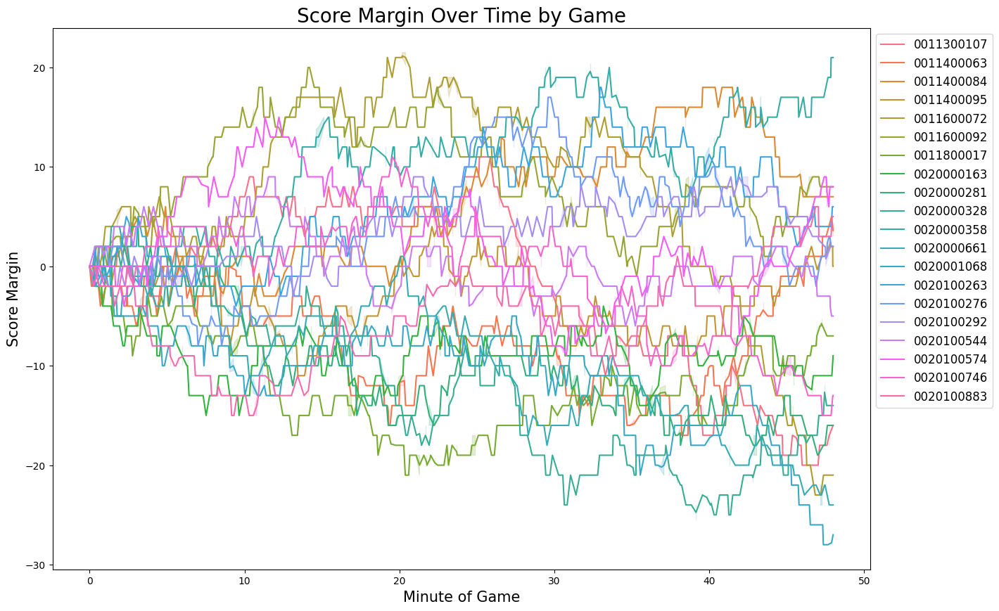

In [0]:
# create a plot of 20 games
fig, ax = plt.subplots(figsize=(15, 10))

sns.lineplot(x='minute_game', y='score_margin_complete', hue='game_id', data=df_game, ax=ax)

plt.title('Score Margin Over Time by Game', fontsize=20)

plt.xlabel('Minute of Game', fontsize=15)
plt.ylabel('Score Margin', fontsize=15)

plt.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=12)
plt.show()

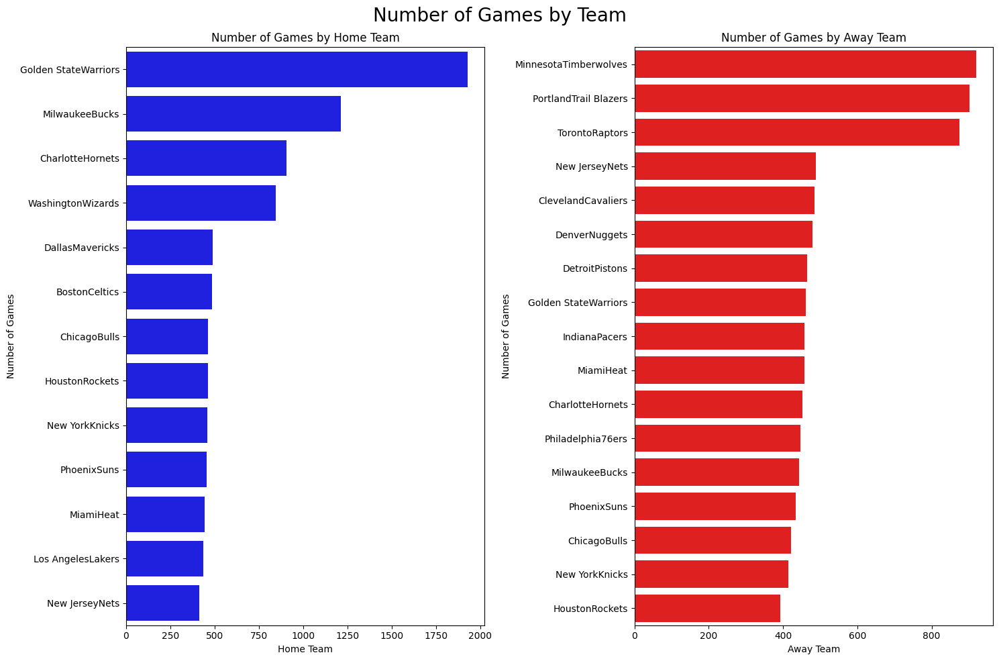

In [0]:
fig, ax = plt.subplots(ncols=2, figsize=(15, 10))

ax[0] = sns.countplot(
    y="home_team",
    data=df_game,
    
    order=df_game["home_team"].value_counts().index,
    color="blue",
    ax=ax[0],
)
ax[0].set_title("Number of Games by Home Team")
ax[0].set_xlabel("Home Team")
ax[0].set_ylabel("Number of Games")

ax[1] = sns.countplot(
    y="away_team",
    data=df_game,
    order=df_game["away_team"].value_counts().index,
    color="red",
    ax=ax[1],
)
ax[1].set_title("Number of Games by Away Team")
ax[1].set_xlabel("Away Team")
ax[1].set_ylabel("Number of Games")

plt.suptitle("Number of Games by Team", fontsize=20)
plt.tight_layout()
plt.show()

In [0]:
display(df_game)

game_id,game_date,event_num,event_type,period,minute_game,season,event_column,home_team,away_team,score_margin_complete,score_complete,away_score_complete,home_score_complete,team_leading_complete
0011300107,10/24/2013 00:00:00,0,12,1,0.0,2013-14,0,Golden StateWarriors,PortlandTrail Blazers,0,0 - 0,0,0,Home
0011300107,10/24/2013 00:00:00,1,10,1,0.0,2013-14,1,Golden StateWarriors,PortlandTrail Blazers,0,0 - 0,0,0,Home
0011300107,10/24/2013 00:00:00,2,5,1,0.17,2013-14,2,Golden StateWarriors,PortlandTrail Blazers,0,0 - 0,0,0,Home
0011300107,10/24/2013 00:00:00,3,1,1,0.45,2013-14,3,Golden StateWarriors,PortlandTrail Blazers,2,0 - 2,0,2,Home
0011300107,10/24/2013 00:00:00,4,2,1,0.68,2013-14,4,Golden StateWarriors,PortlandTrail Blazers,2,0 - 2,0,2,Home
0011300107,10/24/2013 00:00:00,5,4,1,0.7,2013-14,5,Golden StateWarriors,PortlandTrail Blazers,2,0 - 2,0,2,Home
0011300107,10/24/2013 00:00:00,6,2,1,0.9,2013-14,6,Golden StateWarriors,PortlandTrail Blazers,2,0 - 2,0,2,Home
0011300107,10/24/2013 00:00:00,7,4,1,0.92,2013-14,7,Golden StateWarriors,PortlandTrail Blazers,2,0 - 2,0,2,Home
0011300107,10/24/2013 00:00:00,8,2,1,1.02,2013-14,8,Golden StateWarriors,PortlandTrail Blazers,2,0 - 2,0,2,Home
0011300107,10/24/2013 00:00:00,9,4,1,1.05,2013-14,9,Golden StateWarriors,PortlandTrail Blazers,2,0 - 2,0,2,Home


### Check Numerical Univariate Distributions and Correlations

In [0]:
# select numerical columns and check distributions and correlations
numeric_columns = [
    'event_type',
    'period',
    'minute_game',
    'score_margin_complete',
    'away_score_complete',
    'home_score_complete'
]

display(df_game[numeric_columns].describe())

event_type,period,minute_game,score_margin_complete,away_score_complete,home_score_complete
8994.0,8994.0,8994.0,8994.0,8994.0,8994.0
3.923171002890816,2.526573271069602,24.67167667333778,-1.7650655992884146,50.20324660885034,48.43818100956193
2.5125927958740304,1.112895060248032,13.81989242803778,9.543130647569326,28.75505450702331,27.73925496176082
1.0,1.0,0.0,-28.0,0.0,0.0
2.0,2.0,12.73,-9.0,26.0,25.0
4.0,3.0,24.325,-2.0,49.0,49.0
5.0,4.0,36.53,5.0,76.0,71.0
18.0,4.0,48.0,22.0,110.0,120.0


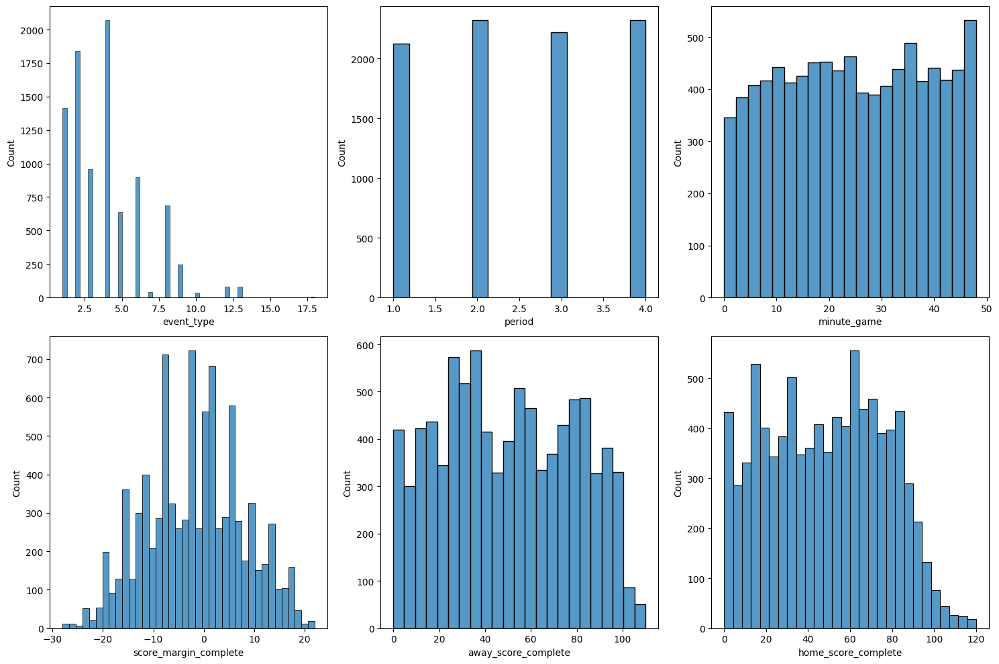

In [0]:
# Plot univariate distributions of numeric columns
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))

for i, column in enumerate(numeric_columns):
    sns.histplot(df_game, x=column, ax=ax[i//3][i%3])

plt.tight_layout()
plt.show()


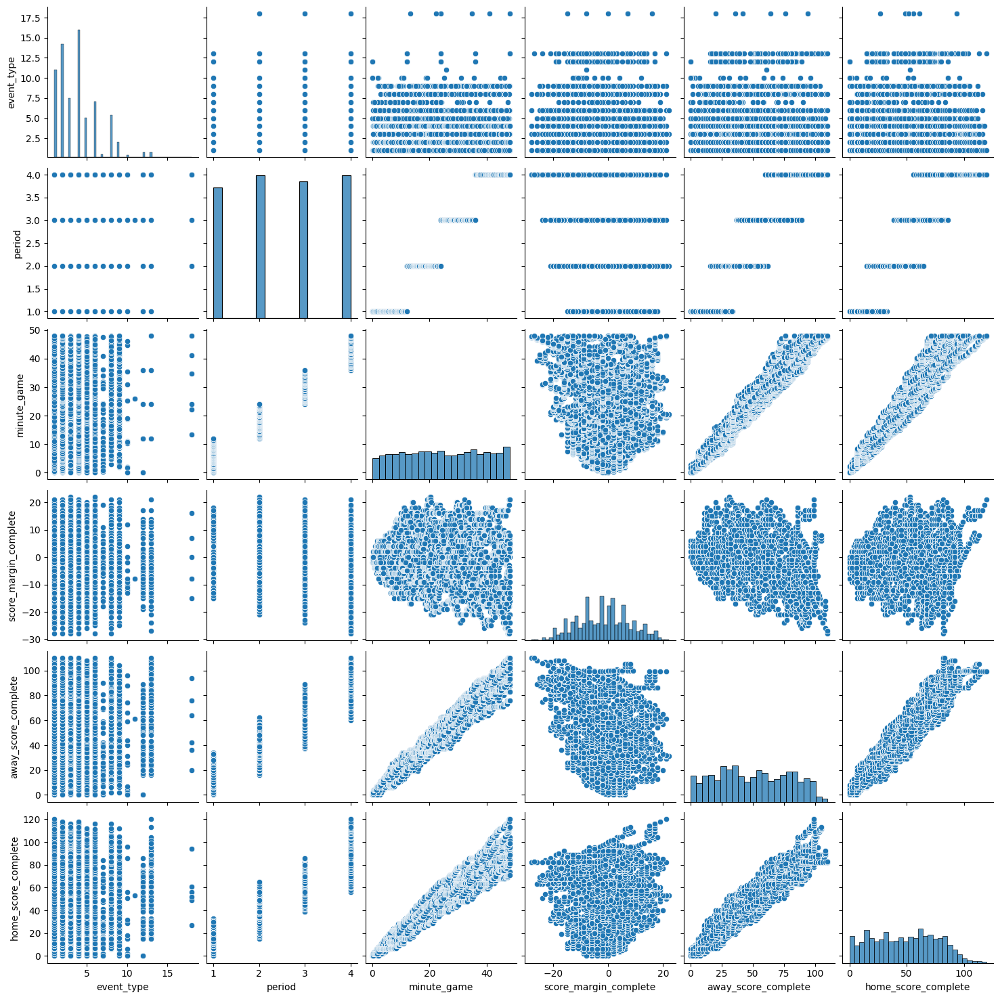

In [0]:
sns.pairplot(df_game[numeric_columns])

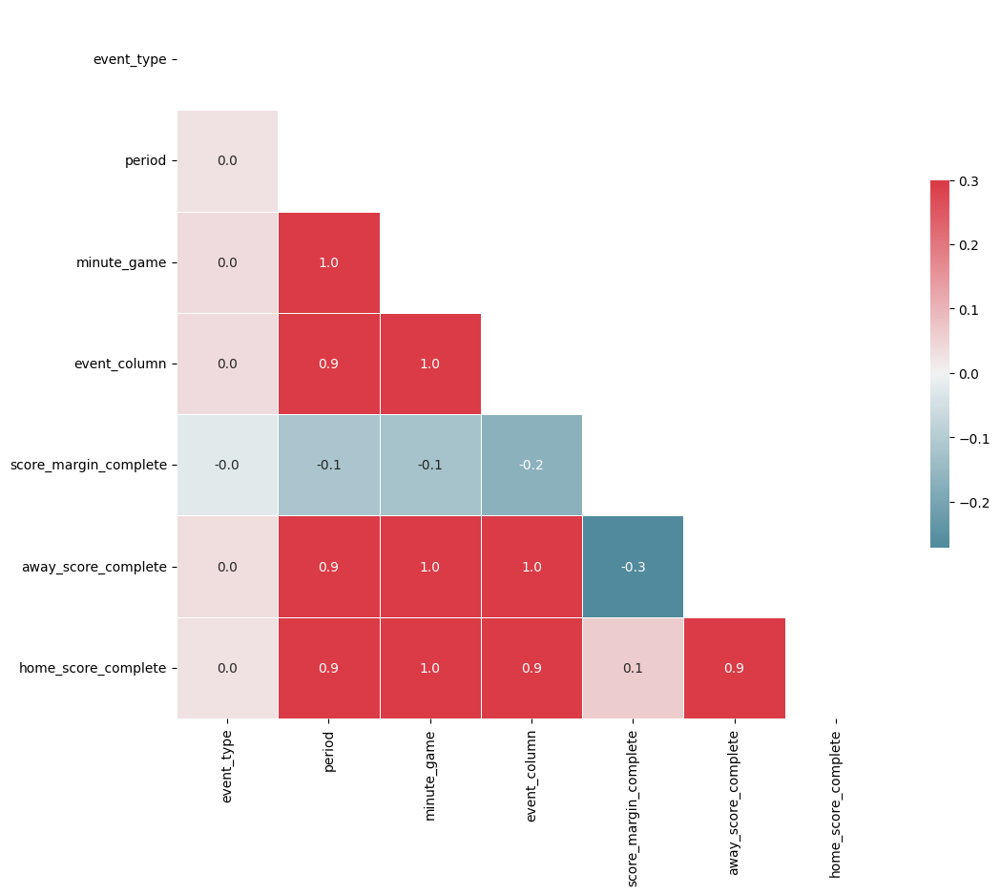

In [0]:
plt.figure(figsize=(12, 10))

corr = df_game.corr()
sns.heatmap(
    corr,
    mask=np.triu(np.ones_like(corr, dtype=bool)),
    cmap=sns.diverging_palette(220, 10, as_cmap=True, center="light"),
    vmax=0.3,
    center=0,
    square=True,
    annot=True,
    fmt=".1f",
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)
plt.show()

### Prepare Data for forecasting 

#### Create Seasonality Variables from game date

In [0]:
# month and day from game_date and year from season
df['game_date'] = ps.to_datetime(df['game_date'])
df['game_month'] = df['game_date'].dt.month
df['game_day'] = df['game_date'].dt.day

df['game_year'] = df['season'].apply(lambda x: x.split('-')[0]).astype(int)

In [0]:
display(df)

game_id,game_date,event_num,event_type,period,minute_game,season,event_column,home_team,away_team,score_margin_complete,score_complete,away_score_complete,home_score_complete,team_leading_complete,game_month,game_day,game_year
0011300110,2013-10-25T00:00:00.000+0000,0,12,1,0.0,2013-14,0,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,1,10,1,0.0,2013-14,1,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,2,5,1,0.18,2013-14,2,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,3,5,1,0.42,2013-14,3,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,4,2,1,0.67,2013-14,4,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,5,4,1,0.7,2013-14,5,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,6,2,1,0.82,2013-14,6,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,7,4,1,0.83,2013-14,7,MemphisGrizzlies,HoustonRockets,0,0 - 0,0,0,Home,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,8,1,1,1.02,2013-14,8,MemphisGrizzlies,HoustonRockets,-3,3 - 0,3,0,Away,10,25,2013
0011300110,2013-10-25T00:00:00.000+0000,9,2,1,1.23,2013-14,9,MemphisGrizzlies,HoustonRockets,-3,3 - 0,3,0,Away,10,25,2013


#### Create within game lagging metrics

In [0]:
### Within game lagging metric
# calculate momentum within a game by taking the difference between the margin 40 events which is just less than the last four minutes of play
# 455 plays per game 455 / 48 is roughly 10 making 40 about 4 minutes
# Hint Use a GroupBy and shift
# remove rows with missing values using dropna and subset

df["score_margin_40_events_ago"] = df.groupby('game_id')['score_margin_complete'].shift(40)

df['momentum_40'] = df['score_margin_complete'] - df['score_margin_40_events_ago']

df = df.dropna(subset=['momentum_40'])

#### Create small and larger dataset by subsetting for only Toronto Raptors and One-Hot Encode Categorical Columns

In [0]:
df_small = df[df['home_team'] == "Toronto_Raptors"]

# rename columns for storing in feature store
df_small.columns = map(lambda x: str(x).replace(" ", "_").lower(), df_small.columns)

In [0]:
df_small = ps.get_dummies(df_small, columns=['event_type', 'away_team'])

In [0]:
display(df_small.info())

<class 'pyspark.pandas.frame.DataFrame'>
Int64Index: 0.0 entries
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   game_id                     0 non-null      object        
 1   game_date                   0 non-null      datetime64[ns]
 2   event_num                   0 non-null      object        
 3   period                      0 non-null      int32         
 4   minute_game                 0 non-null      float64       
 5   season                      0 non-null      object        
 6   event_column                0 non-null      int32         
 7   home_team                   0 non-null      object        
 8   score_margin_complete       0 non-null      int32         
 9   score_complete              0 non-null      object        
 10  away_score_complete         0 non-null      int32         
 11  home_score_complete         0 non-null      int32         
 12  t

### Write to Feature Store

In [0]:
spark_df_small = df_small.to_spark()

/local_disk0/.ephemeral_nfs/envs/pythonEnv-761b1456-f652-48a6-a4da-671d0ea31f1b/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


---------------------------------------------------------------------------
PySparkTypeError                          Traceback (most recent call last)
File <command-1263671250825165>, line 1
----> 1 spark_df_small = spark.createDataFrame(df_small.astype('str'))

File /databricks/spark/python/pyspark/instrumentation_utils.py:48, in _wrap_function.<locals>.wrapper(*args, **kwargs)
     46 start = time.perf_counter()
     47 try:
---> 48     res = func(*args, **kwargs)
     49     logger.log_success(
     50         module_name, class_name, function_name, time.perf_counter() - start, signature
     51     )
     52     return res

File /databricks/spark/python/pyspark/sql/session.py:1407, in SparkSession.createDataFrame(self, data, schema, samplingRatio, verifySchema)
   1402 if has_pandas and isinstance(data, pd.DataFrame):
   1403     # Create a DataFrame from pandas DataFrame.
   1404     return super(SparkSession, self).createDataFrame(  # type: ignore[call-overload]
   1405         

In [0]:
# replace example_schema with your schema
table_name = "hackathon.team_4.ml_nba_game_features_small"
fs = FeatureStoreClient()

# write code to write to feature store below
fs.write_table(
    table_name,
    df = spark_df_small,
    mode="overwrite"
    
)

/local_disk0/.ephemeral_nfs/envs/pythonEnv-761b1456-f652-48a6-a4da-671d0ea31f1b/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
